In [1]:
import sys
from os import listdir
from os.path import isfile, join
import numpy as np
import matplotlib.pyplot as plt

In [2]:
path = 'results/'

In [3]:
wireplane = '_V_'
filenames = [path+f for f in listdir(path) if (isfile(join(path, f)) and wireplane in f)]
for i in range(len(filenames)):
    print(filenames[i])

results/train_target_sig_V_1.npy
results/train_target_sig_V_2.npy
results/train_target_sig_V_3.npy


In [4]:
out_V_1 = np.load(filenames[0])
out_V_2 = np.load(filenames[1])
out_V_3 = np.load(filenames[2])

In [5]:
path = 'processed_data/'
fn = [path+f for f in listdir(path) if (isfile(join(path, f)) and wireplane[1]+'.npy' in f)]
for i in range(6):
    print(fn[i])

processed_data/x_test_V.npy
processed_data/x_train_V.npy
processed_data/y_test_flat_noise_target_V.npy
processed_data/y_test_V.npy
processed_data/y_train_flat_noise_target_V.npy
processed_data/y_train_V.npy


In [6]:
x_test = np.load(fn[0])
x_train = np.load(fn[1])
y_test_flat_noise_target = np.load(fn[2])

y_test = np.load(fn[3])
y_train_flat_noise_target = np.load(fn[4])
y_train = np.load(fn[5])

In [7]:
mean = x_train.mean()
std = x_train.std()

In [9]:
out_V_1_unscaled = std*out_V_1 + mean
out_V_2_unscaled = std*out_V_2 + mean
out_V_3_unscaled = std*out_V_3 + mean

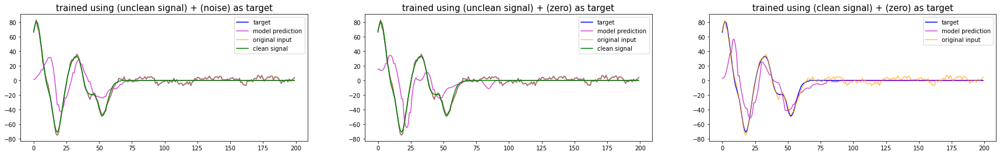

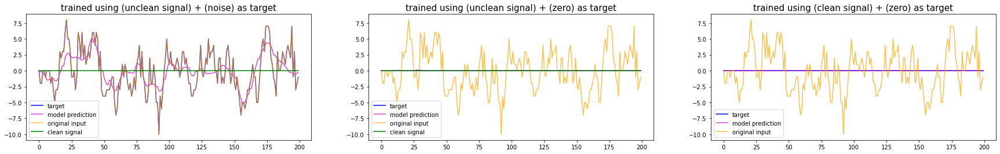

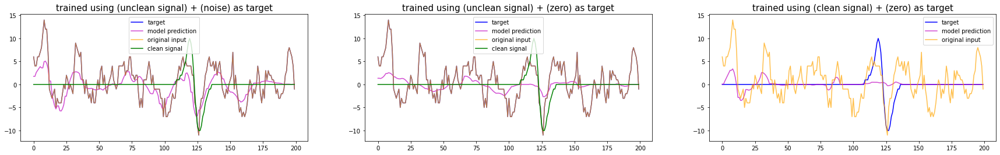

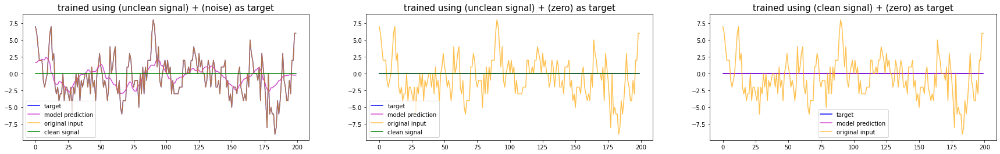

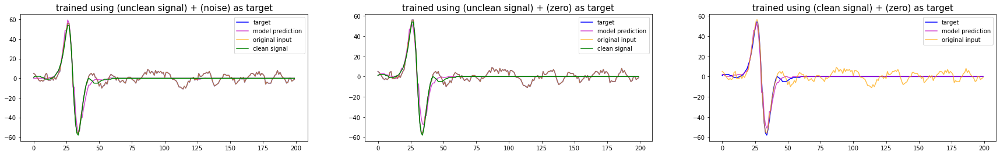

...

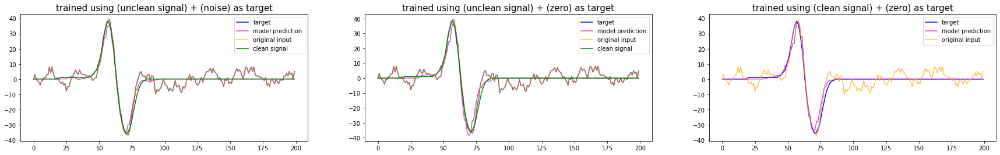

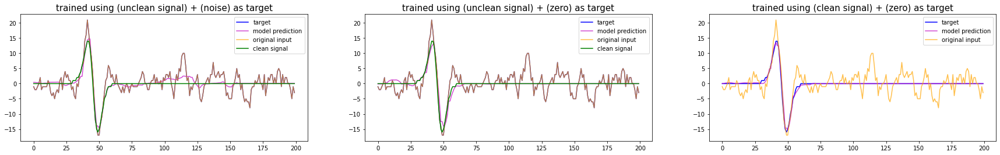

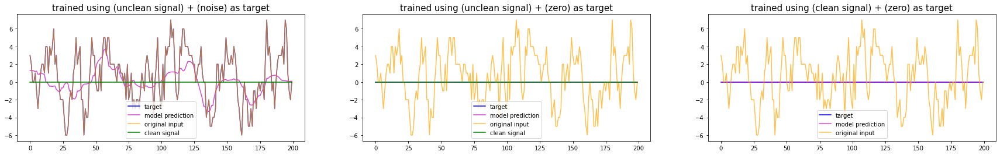

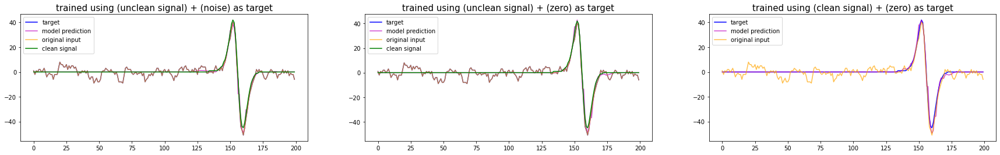

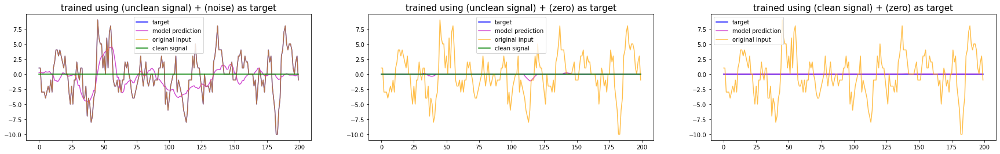

In [10]:
for idx in range(200):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 4))
    ax1.plot(x_test[idx],color='blue', label='target')
    ax1.plot(out_V_1_unscaled[idx],color='m',alpha=0.7, label='model prediction')
    ax1.plot(x_test[idx], color='orange',alpha=0.7, label = 'original input')
    ax1.plot(y_test[idx], color='green', label = 'clean signal')
    ax1.set_title("trained using (unclean signal) + (noise) as target", fontsize=15)
    ax1.legend()

    ax2.plot(y_test_flat_noise_target[idx],color='blue', label='target')
    ax2.plot(out_V_2_unscaled[idx],color='m',alpha=0.7, label='model prediction')
    ax2.plot(x_test[idx], color='orange',alpha=0.7, label = 'original input')
    ax2.plot(y_test[idx], color='green', label = 'clean signal')
    ax2.set_title("trained using (unclean signal) + (zero) as target", fontsize=15)
    ax2.legend()

    ax3.plot(y_test[idx],color='blue', label='target')
    ax3.plot(out_V_3_unscaled[idx],color='m',alpha=0.7, label='model prediction')
    ax3.plot(x_test[idx], color='orange',alpha=0.7, label = 'original input')
    ax3.set_title("trained using (clean signal) + (zero) as target", fontsize=15)
    ax3.legend()


    plt.show()